In [1]:
#import packages & libraries
from prophet import Prophet
from prophet.plot import plot_plotly, plot_components_plotly
import pandas as pd
import numpy as np
%matplotlib inline
import plotly.express as px

In [2]:
#initialize plotly
import plotly.io as pio
pio.renderers.default = 'colab'

## Exploratory Data Analysis

In [3]:
df = pd.read_csv('./../datasets/conso-inf36-region.csv', sep=';')
df.head(1000)

,Horodate,Région,Code région,Profil,Plage de puissance souscrite,Nb points soutirage,Total énergie soutirée (Wh),Courbe Moyenne n°1 (Wh),Indice représentativité Courbe n°1 (%),Courbe Moyenne n°2 (Wh),Indice représentativité Courbe n°2 (%),Courbe Moyenne n°1 + n°2 (Wh),Indice représentativité Courbe n°1 + n°2 (%),Jour max du mois (0/1),Semaine max du mois (0/1)
0,2021-12-31T23:30:00+01:00,Nouvelle Aquitaine,75,ENT3 (+ ENT4 + ENT5),P0: Total <= 36 kVA,1387,2536714.0,1696.0,49,1922.0,49,1808.0,98,0,0
1,2021-12-31T23:30:00+01:00,Nouvelle Aquitaine,75,PRO1 (+ PRO1WE),P6: ]15-18] kVA,33278,15855016.0,705.0,11,513.0,11,535.0,23,0,0
2,2021-12-31T23:30:00+01:00,Nouvelle Aquitaine,75,PRO2 (+ PRO2WE + PRO6),P0: Total <= 36 kVA,90492,74615055.0,968.0,16,765.0,16,865.0,33,0,0
3,2021-12-31T23:30:00+01:00,Nouvelle Aquitaine,75,PRO2 (+ PRO2WE + PRO6),P9: ]30-36] kVA,12211,20583252.0,1875.0,16,1476.0,16,1676.0,33,0,0
4,2021-12-31T23:30:00+01:00,Nouvelle Aquitaine,75,PRO4,P6: ]15-18] kVA,5046,1932834.0,556.0,12,295.0,12,425.0,24,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
995,2021-12-31T17:30:00+01:00,Nouvelle Aquitaine,75,RES2WE,P4: ]9-12] kVA,2145,1268094.0,679.0,17,719.0,17,699.0,35,0,0
996,2021-12-31T17:30:00+01:00,Nouvelle Aquitaine,75,RES3,P0: Total <= 36 kVA,26290,13363589.0,507.0,9,542.0,9,524.0,18,0,0
997,2021-12-31T17:30:00+01:00,Nouvelle Aquitaine,75,RES3,P4: ]9-12] kVA,3892,2192270.0,577.0,10,643.0,9,609.0,20,0,0
998,2021-12-31T17:30:00+01:00,Nouvelle Aquitaine,75,PRO2 (+ PRO2WE + PRO6),P7: ]18-24] kVA,5256,8401961.0,1798.0,14,1217.0,14,1507.0,28,0,0


In [4]:
#reduce information
df.drop(['Région', 'Code région', 'Plage de puissance souscrite', 'Nb points soutirage', 'Total énergie soutirée (Wh)',
         'Courbe Moyenne n°1 (Wh)', 'Indice représentativité Courbe n°1 (%)', 'Courbe Moyenne n°2 (Wh)',
         'Indice représentativité Courbe n°2 (%)', 'Indice représentativité Courbe n°1 + n°2 (%)',
         'Jour max du mois (0/1)', 'Semaine max du mois (0/1)'], axis='columns', inplace=True)
df.dropna(inplace=True)
df['Horodate'] = pd.to_datetime(df['Horodate'].values, utc=True)
df['Horodate'] = df['Horodate'].dt.tz_localize(None)
df.head(100)

,Horodate,Profil,Courbe Moyenne n°1 + n°2 (Wh)
0,2021-12-31 22:30:00,ENT3 (+ ENT4 + ENT5),1808.0
1,2021-12-31 22:30:00,PRO1 (+ PRO1WE),535.0
2,2021-12-31 22:30:00,PRO2 (+ PRO2WE + PRO6),865.0
3,2021-12-31 22:30:00,PRO2 (+ PRO2WE + PRO6),1676.0
4,2021-12-31 22:30:00,PRO4,425.0
...,...,...,...
108,2021-12-31 22:00:00,PRO3,964.0
110,2021-12-31 22:00:00,PRO5,343.0
111,2021-12-31 22:00:00,PRO5,1891.0
112,2021-12-31 22:00:00,RES11 (+ RES11WE),663.0


In [5]:
df = df[df['Profil'].str.contains("RES")]
df = df.groupby('Horodate').sum().iloc[::-1]
df = df.reset_index()
df.head(1000)

,Horodate,Courbe Moyenne n°1 + n°2 (Wh)
0,2021-12-31 22:30:00,23516.0
1,2021-12-31 22:00:00,23408.0
2,2021-12-31 21:30:00,23527.0
3,2021-12-31 21:00:00,23074.0
4,2021-12-31 20:30:00,23013.0
...,...,...
995,2021-12-11 05:00:00,29107.0
996,2021-12-11 04:30:00,28791.0
997,2021-12-11 04:00:00,28771.0
998,2021-12-11 03:30:00,28577.0


In [6]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 35088 entries, 0 to 35087
Data columns (total 2 columns):
 #   Column                         Non-Null Count  Dtype         
---  ------                         --------------  -----         
 0   Horodate                       35088 non-null  datetime64[ns]
 1   Courbe Moyenne n°1 + n°2 (Wh)  35088 non-null  float64       
dtypes: datetime64[ns](1), float64(1)
memory usage: 548.4 KB


In [7]:
df.describe()

,Courbe Moyenne n°1 + n°2 (Wh)
count,35088.000000
mean,17767.730050
std,6008.733365
min,7961.000000
25%,12813.000000
50%,15645.500000
75%,21732.000000
max,39490.000000


## Data Visualization

In [26]:
#area graph (Date Vs Price)
px.scatter(df,
           x='Horodate',
           y='Courbe Moyenne n°1 + n°2 (Wh)')

In [27]:
#violin plot
px.violin(df,
          y='Courbe Moyenne n°1 + n°2 (Wh)')

## Data Preparation

In [10]:
#get columns' names
df.columns

Index(['Horodate', 'Courbe Moyenne n°1 + n°2 (Wh)'], dtype='object')

In [11]:
#rename columns
prophet_df = df.rename(columns={'Horodate': 'ds',
                                'Courbe Moyenne n°1 + n°2 (Wh)': 'y'})

#check
prophet_df["cap"] = prophet_df["y"].max()*1.2
prophet_df["floor"] = 0
prophet_df.columns

Index(['ds', 'y', 'cap', 'floor'], dtype='object')

In [12]:
MAX_DATE = prophet_df['ds'].max()
MAX_DATE

Timestamp('2021-12-31 22:30:00')

## Train Model

In [13]:
#initialize
model = Prophet(daily_seasonality=True,
                weekly_seasonality=50,
                yearly_seasonality=30,
                seasonality_mode='additive',
                changepoint_prior_scale=0.001,
                growth="logistic")
#model.add_country_holidays(country_name='FR')
#fit
model.fit(prophet_df)

In [14]:
#forecast for the next quarter
# 90 days = 2160 hours = 4320 half-hours ==> coeff of 48
future = model.make_future_dataframe(periods=365 * 48, freq='30min')
future["cap"] = prophet_df["y"].max()*1.2
future["floor"] = 0
#predict
forecast = model.predict(future)

In [15]:
forecast

,ds,trend,cap,floor,yhat_lower,yhat_upper,trend_lower,trend_upper,additive_terms,additive_terms_lower,...,weekly,weekly_lower,weekly_upper,yearly,yearly_lower,yearly_upper,multiplicative_terms,multiplicative_terms_lower,multiplicative_terms_upper,yhat
0,2019-12-31 23:00:00,15069.216201,47388.0,0,20793.247397,26620.772922,15069.216201,15069.216201,8873.108452,8873.108452,...,-272.063007,-272.063007,-272.063007,9071.024580,9071.024580,9071.024580,0.0,0.0,0.0,23942.324653
1,2019-12-31 23:30:00,15069.410175,47388.0,0,20866.623688,27044.348180,15069.410175,15069.410175,8852.442505,8852.442505,...,-285.045632,-285.045632,-285.045632,9091.180508,9091.180508,9091.180508,0.0,0.0,0.0,23921.852681
2,2020-01-01 00:00:00,15069.604151,47388.0,0,21015.303098,26909.263928,15069.604151,15069.604151,8902.305898,8902.305898,...,-200.632952,-200.632952,-200.632952,9111.357143,9111.357143,9111.357143,0.0,0.0,0.0,23971.910049
3,2020-01-01 00:30:00,15069.798128,47388.0,0,21035.089105,27006.178216,15069.798128,15069.798128,8917.998706,8917.998706,...,-121.278206,-121.278206,-121.278206,9131.553717,9131.553717,9131.553717,0.0,0.0,0.0,23987.796834
4,2020-01-01 01:00:00,15069.992106,47388.0,0,21019.881211,27009.768703,15069.992106,15069.992106,8814.100992,8814.100992,...,-139.295804,-139.295804,-139.295804,9151.769461,9151.769461,9151.769461,0.0,0.0,0.0,23884.093099
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
52603,2022-12-31 20:30:00,23198.603996,47388.0,0,30279.186429,36624.662892,22952.978258,23445.305921,10248.512821,10248.512821,...,817.271109,817.271109,817.271109,9212.524046,9212.524046,9212.524046,0.0,0.0,0.0,33447.116817
52604,2022-12-31 21:00:00,23198.768003,47388.0,0,30321.043252,36523.136641,22953.111461,23445.488672,10313.422221,10313.422221,...,924.840692,924.840692,924.840692,9232.808805,9232.808805,9232.808805,0.0,0.0,0.0,33512.190224
52605,2022-12-31 21:30:00,23198.932011,47388.0,0,30497.371660,36548.421723,22953.244663,23445.671424,10274.387338,10274.387338,...,906.854493,906.854493,906.854493,9253.108906,9253.108906,9253.108906,0.0,0.0,0.0,33473.319349
52606,2022-12-31 22:00:00,23199.096018,47388.0,0,30244.615474,36291.604658,22953.377866,23445.854175,10121.426392,10121.426392,...,754.079974,754.079974,754.079974,9273.423585,9273.423585,9273.423585,0.0,0.0,0.0,33320.522410


In [16]:
forecast.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 52608 entries, 0 to 52607
Data columns (total 24 columns):
 #   Column                      Non-Null Count  Dtype         
---  ------                      --------------  -----         
 0   ds                          52608 non-null  datetime64[ns]
 1   trend                       52608 non-null  float64       
 2   cap                         52608 non-null  float64       
 3   floor                       52608 non-null  int64         
 4   yhat_lower                  52608 non-null  float64       
 5   yhat_upper                  52608 non-null  float64       
 6   trend_lower                 52608 non-null  float64       
 7   trend_upper                 52608 non-null  float64       
 8   additive_terms              52608 non-null  float64       
 9   additive_terms_lower        52608 non-null  float64       
 10  additive_terms_upper        52608 non-null  float64       
 11  daily                       52608 non-null  float64   

In [17]:
forecast.describe()

,trend,cap,floor,yhat_lower,yhat_upper,trend_lower,trend_upper,additive_terms,additive_terms_lower,additive_terms_upper,...,weekly,weekly_lower,weekly_upper,yearly,yearly_lower,yearly_upper,multiplicative_terms,multiplicative_terms_lower,multiplicative_terms_upper,yhat
count,52608.000000,52608.0,52608.0,52608.000000,52608.000000,52608.000000,52608.000000,52608.000000,52608.000000,52608.000000,...,52608.000000,52608.000000,52608.000000,52608.000000,52608.000000,52608.000000,52608.0,52608.0,52608.0,52608.000000
mean,19099.543859,47388.0,0.0,16063.164854,22139.778756,19067.275176,19131.948989,1.763809,1.763809,1.763809,...,-0.330678,-0.330678,-0.330678,2.094487,2.094487,2.094487,0.0,0.0,0.0,19101.307668
std,2274.775022,0.0,0.0,5789.457688,5790.205382,2228.372471,2322.050703,5521.406518,5521.406518,5521.406518,...,557.111434,557.111434,557.111434,5474.993967,5474.993967,5474.993967,0.0,0.0,0.0,5787.654199
min,15069.216201,47388.0,0.0,5720.848564,11760.463762,15069.216201,15069.216201,-8061.685473,-8061.685473,-8061.685473,...,-1051.727313,-1051.727313,-1051.727313,-6502.536757,-6502.536757,-6502.536757,0.0,0.0,0.0,8746.064178
25%,17179.427767,47388.0,0.0,11361.429438,17445.610289,17179.427767,17179.427767,-4829.487805,-4829.487805,-4829.487805,...,-383.959286,-383.959286,-383.959286,-4855.508321,-4855.508321,-4855.508321,0.0,0.0,0.0,14403.422788
50%,18953.066104,47388.0,0.0,14787.781227,20863.425177,18953.066104,18953.066104,-1837.726648,-1837.726648,-1837.726648,...,-116.985405,-116.985405,-116.985405,-2019.426694,-2019.426694,-2019.426694,0.0,0.0,0.0,17821.642303
75%,21052.291028,47388.0,0.0,20539.675310,26603.911642,21024.679712,21081.598447,4651.923469,4651.923469,4651.923469,...,290.540239,290.540239,290.540239,4609.398133,4609.398133,4609.398133,0.0,0.0,0.0,23564.848907
max,23199.260025,47388.0,0.0,32530.663212,38504.859179,22953.511069,23446.036927,14979.806243,14979.806243,14979.806243,...,1684.811814,1684.811814,1684.811814,13412.702008,13412.702008,13412.702008,0.0,0.0,0.0,35392.496904


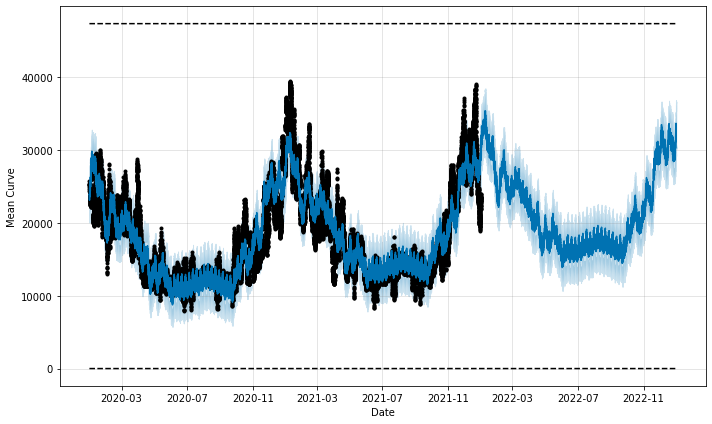

In [18]:
#visualize with Facebook internal tool
figure_1 = model.plot(forecast,
                      xlabel='Date',
                      ylabel='Mean Curve')

In [24]:
plot_plotly(model, forecast).show()

In [25]:
plot_components_plotly(model, forecast).show()

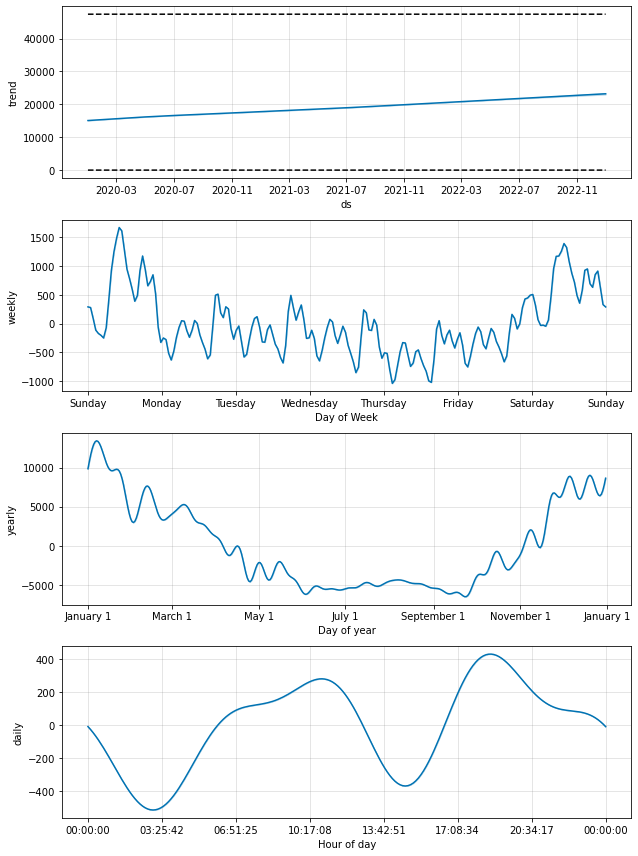

In [21]:
#visualize forecast
figure_2 = model.plot_components(forecast)

(19195.0, 19196.0)

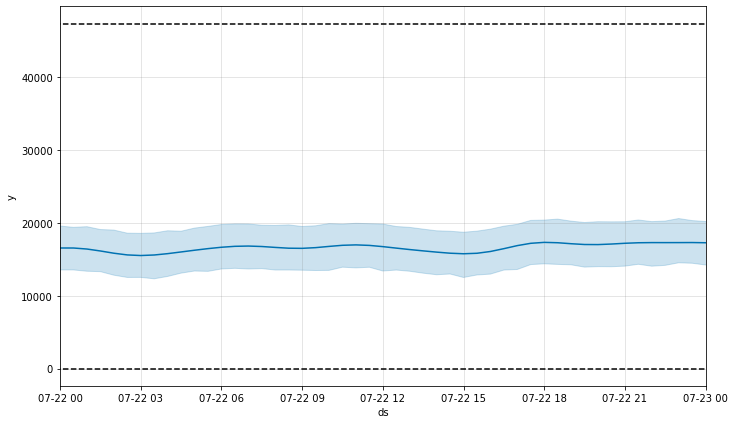

In [22]:
#Plot a specific day
fig = model.plot(forecast)
ax = fig.gca()
ax.set_xlim(pd.to_datetime(['2022-07-22', '2022-07-23']))

(19348.0, 19349.0)

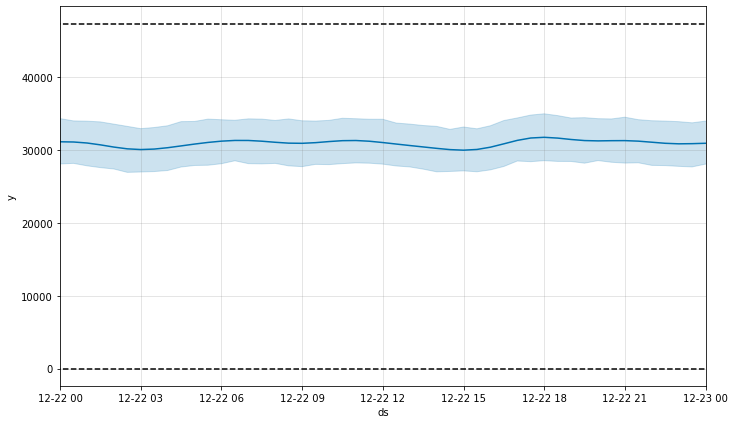

In [23]:
#Plot a specific day
fig = model.plot(forecast)
ax = fig.gca()
ax.set_xlim(pd.to_datetime(['2022-12-22', '2022-12-23']))